<a href="https://colab.research.google.com/github/bysliu/DATA205/blob/main/data205_captone_basic_eda.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import numpy as np
import folium

In [5]:
main_merge = pd.read_csv('Merged_Collison_Data.csv', parse_dates=['Crash Date/Time'])

<ipython-input-5-76e1c7e908d3>:1: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  main_merge = pd.read_csv('Merged_Collison_Data.csv', parse_dates=['Crash Date/Time'])


In [6]:
print('Shape of the data:\n', main_merge.shape, 'row by column')
print()
#main_merge.info()

# .describe() is not helpful
#main_merge.describe()

print('All the coulmns in main_merge data\n', main_merge.columns)
print()

the_coulmn = 'Municipality'
print('The column:',the_coulmn, ', has this many unique values:',main_merge[the_coulmn].nunique())
print()
# There is no null cuz i added unknown to all nulls
print('Top 10 columns with null values:\n',main_merge.isnull().sum().sort_values(ascending= False).head(10))

Shape of the data:
 (221609, 64) row by column

All the coulmns in main_merge data
 Index(['Unnamed: 0', 'Report Number', 'Local Case Number', 'Agency Name',
       'ACRS Report Type', 'Crash Date/Time', 'Route Type', 'Road Name',
       'Cross-Street Name', 'Off-Road Description', 'Municipality',
       'Related Non-Motorist', 'Collision Type', 'Weather',
       'Surface Condition', 'Light', 'Traffic Control',
       'Driver Substance Abuse', 'Non-Motorist Substance Abuse', 'Person ID',
       'Driver At Fault', 'Injury Severity', 'Circumstance',
       'Driver Distracted By', 'Drivers License State', 'Vehicle ID',
       'Vehicle Damage Extent', 'Vehicle First Impact Location',
       'Vehicle Body Type', 'Vehicle Movement', 'Vehicle Going Dir',
       'Speed Limit', 'Driverless Vehicle', 'Parked Vehicle', 'Vehicle Year',
       'Vehicle Make', 'Vehicle Model', 'Latitude', 'Longitude', 'Geolocation',
       'Hit/Run', 'Lane Direction', 'Lane Type', 'Number of Lanes',
       'Directio

In [12]:
eda_2024 = main_merge[main_merge['Year'] == 2024]
eda_2024['Road Name'].value_counts().head(10)

,count
Road Name,
GEORGIA AVE,642
GEORGIA AVE (SB/L),564
NEW HAMPSHIRE AVE,407
NEW HAMPSHIRE AVE (SB/L),365
CONNECTICUT AVE,307
COLUMBIA PIKE,295
FREDERICK RD,285
ROCKVILLE PIKE,283
COLUMBIA PIKE (SB/L),254


In [13]:
top_roads_per_year = (
    main_merge.groupby(['Year', 'Road Name'])
      .size()
      .reset_index(name='count')
      .sort_values(['Year', 'count'], ascending=[True, False])
      .groupby('Year')
      .head(8)
)
top_roads_per_year.to_csv('Top_roads.csv')

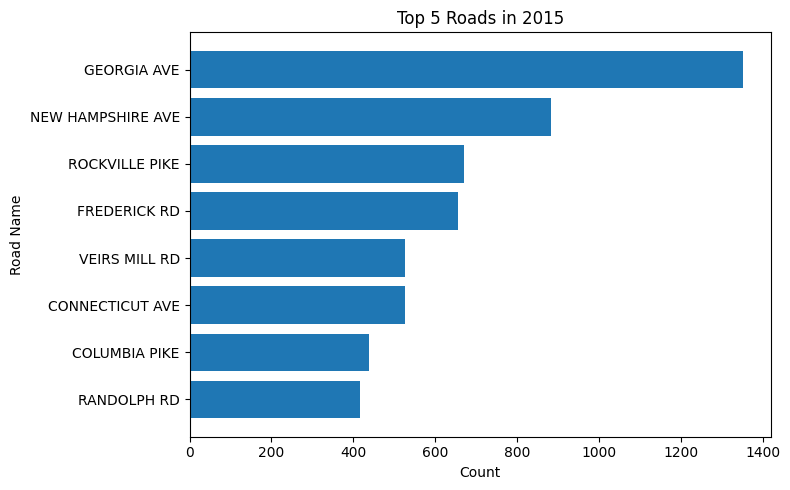

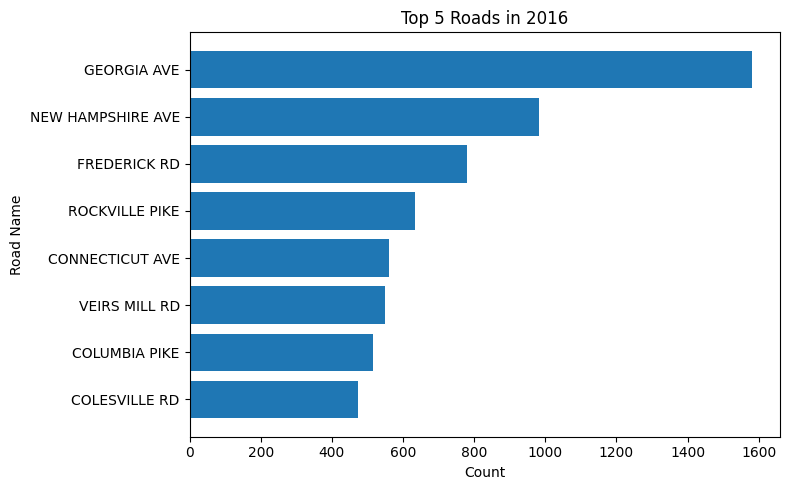

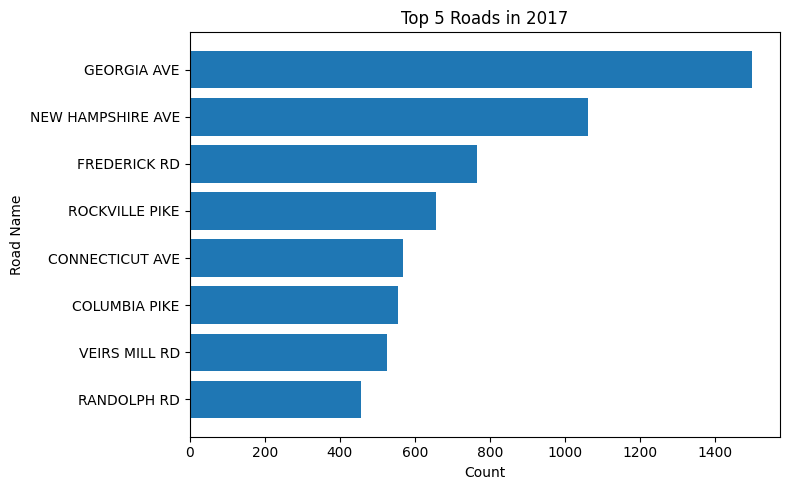

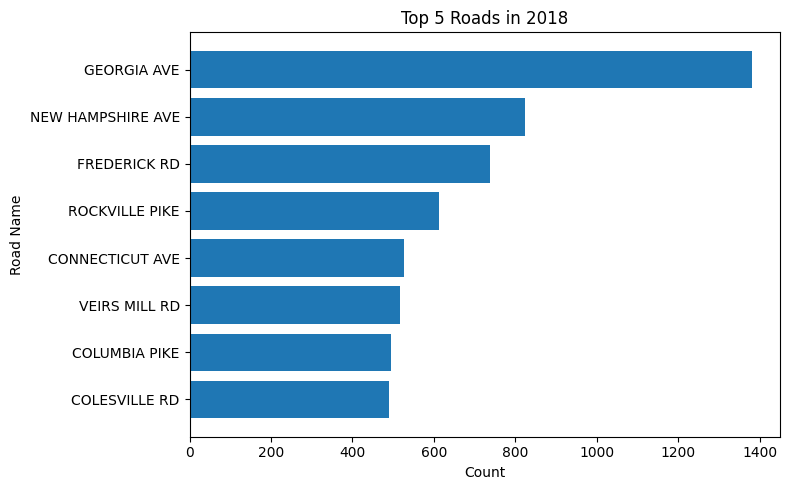

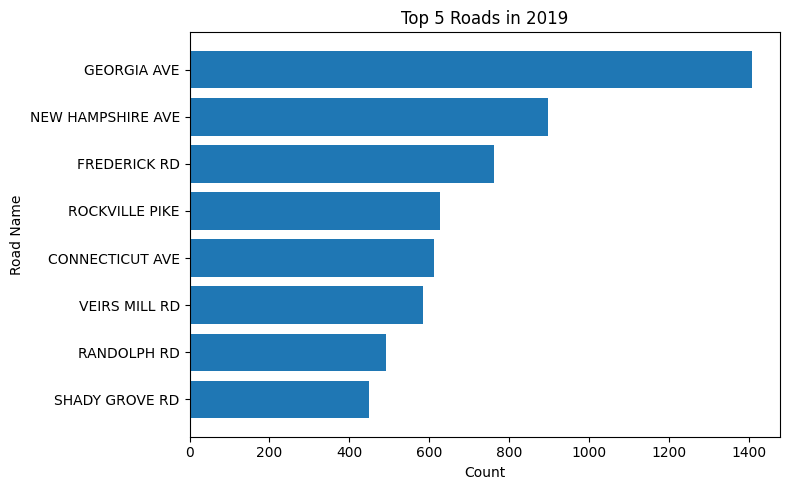

...

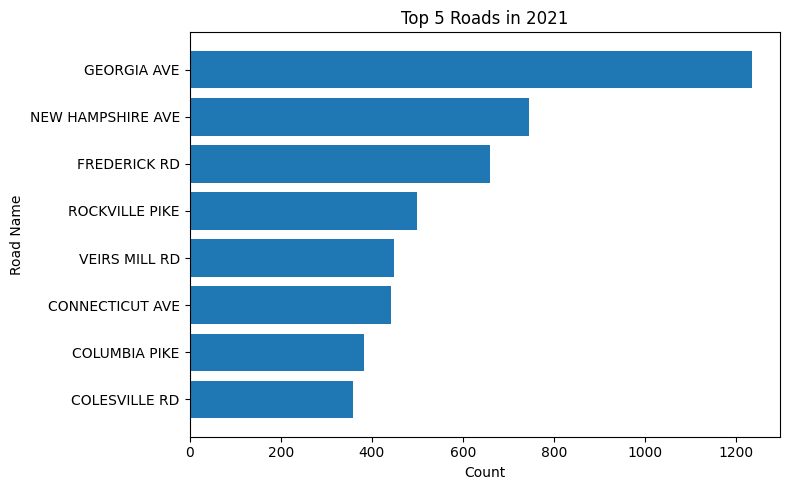

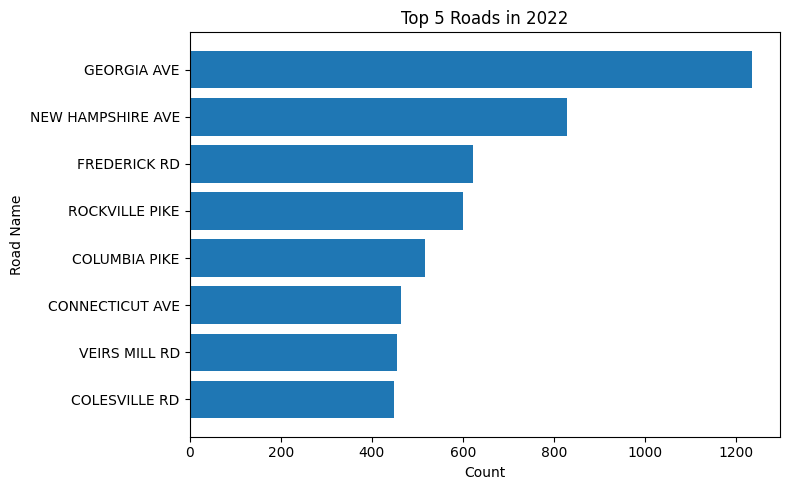

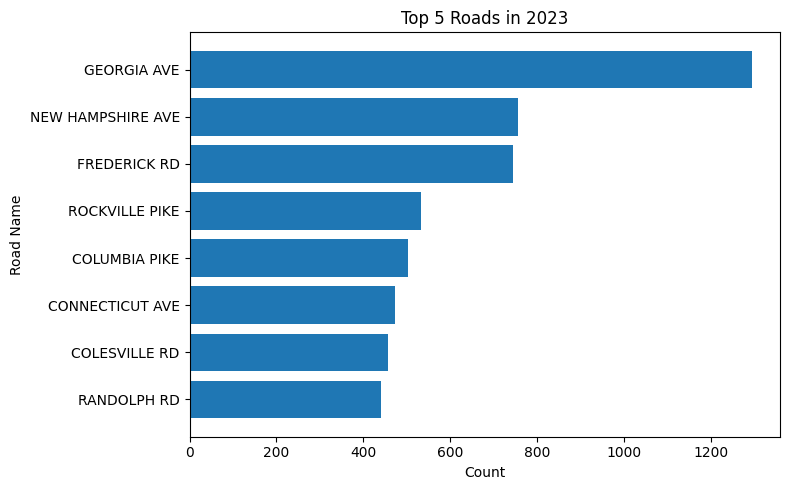

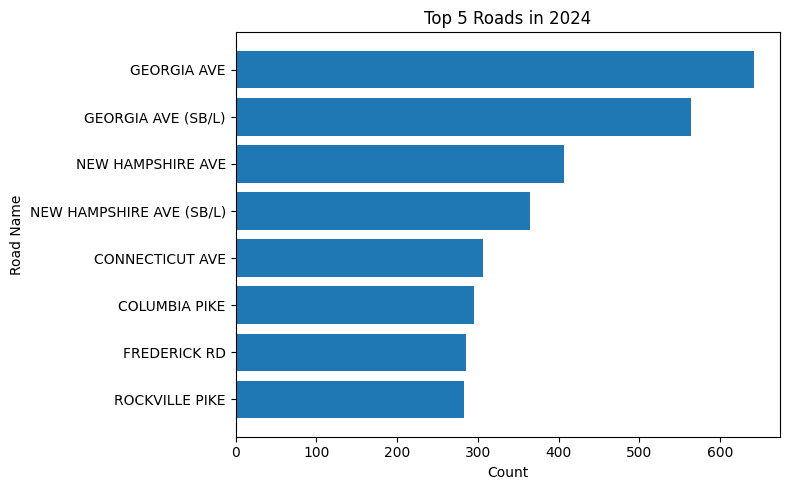

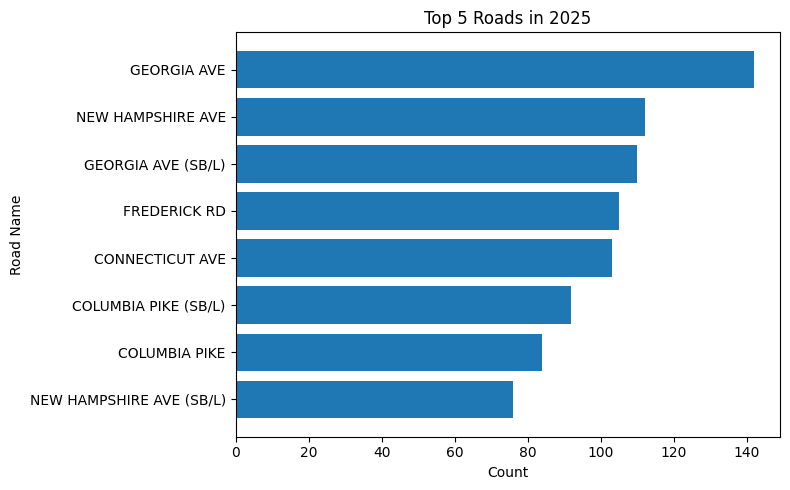

In [14]:
# Get the unique years to plot one graph per year
years = top_roads_per_year['Year'].unique()

for year in years:
    data = top_roads_per_year[top_roads_per_year['Year'] == year]
    plt.figure(figsize=(8, 5))
    plt.barh(data['Road Name'], data['count'])
    plt.title(f'Top 5 Roads in {year}')
    plt.xlabel('Count')
    plt.ylabel('Road Name')
    plt.gca().invert_yaxis()  # Highest on top
    plt.tight_layout()
    plt.show()

In [15]:
import re

# This pattern matches "Georgia Ave" with optional things after it like " (SB/l)", "(NB)", etc.
pattern = r'\bGeorgia Ave\b.*'

georgia_ave = eda_2024[eda_2024['Road Name'].str.contains(pattern, flags=re.IGNORECASE, na=False, regex=True)]
georgia_ave['Circumstance'].value_counts().head(10)


,count
Circumstance,
Failed to Yield Right-of-Way,39
Followed Too Closely,26
Other Improper Action,15
"Operated Motor Vehicle in Inattentive, Careless, Negligent, or Erratic Manner",12
Too Fast For Conditions,11
Failed to Keep in Proper Lane,11
"Followed Too Closely, Operated Motor Vehicle in Inattentive",6
"Failed to Yield Right-of-Way, Improper Turn",5
"Followed Too Closely, Too Fast For Conditions",5


In [16]:
georgia_ave = eda_2024[eda_2024['Road Name'].str.contains('Georgia Ave', case=False, na=False)]
georgia_ave['Circumstance'].value_counts().head(10)


,count
Circumstance,
Failed to Yield Right-of-Way,39
Followed Too Closely,26
Other Improper Action,15
"Operated Motor Vehicle in Inattentive, Careless, Negligent, or Erratic Manner",12
Too Fast For Conditions,11
Failed to Keep in Proper Lane,11
"Followed Too Closely, Operated Motor Vehicle in Inattentive",6
"Failed to Yield Right-of-Way, Improper Turn",5
"Followed Too Closely, Too Fast For Conditions",5


In [17]:
eda_2024.shape

(25872, 64)

In [18]:
pd.crosstab(eda_2024['Driver At Fault'], eda_2024['Driver Substance Abuse'])

Driver Substance Abuse,Not Suspect of Alcohol Use,"Not Suspect of Alcohol Use, Suspect of Drug Use",Not Suspect of Alcohol or Drug Use,Not Suspect of Drug Use,Nothing Detected,Suspect of Alcohol Use,"Suspect of Alcohol Use, Not Suspect of Drug Use","Suspect of Alcohol Use, Suspect of Drug Use",Suspect of Drug Use,Unknown
Driver At Fault,,,,,,,,,,
No,16,8,10883,21,0,17,150,8,0,1606
Yes,16,16,5107,19,2,40,328,25,2,321


In [20]:
# Filter 'Road Name' contains 'Georgia Ave' (case insensitive)
georgia_ave_points = eda_2024[eda_2024['Road Name'].str.contains('Georgia Ave', case=False, na=False)]

# Create map
m = folium.Map(location=[georgia_ave_points['Latitude'].mean(), georgia_ave_points['Longitude'].mean()],
               zoom_start=13)

# Add CircleMarker
for i in georgia_ave_points.itertuples():
    folium.CircleMarker(location=[i.Latitude, i.Longitude], radius=2).add_to(m)

# Display
m

In [22]:

#preferred order
severity_order = ['Fatal Injury', 'Suspected Serious Injury', 'Suspected Minor Injury', 'Possible Injury' ,'No Apparent Injury']

# Convert to Categorical
eda_2024['Injury Severity'] = pd.Categorical(
    eda_2024['Injury Severity'],
    categories=severity_order,
    ordered=True
)

# crosstab
pd.crosstab(eda_2024['Collision Type'], eda_2024['Injury Severity'])

<ipython-input-22-4543553970af>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eda_2024['Injury Severity'] = pd.Categorical(


Injury Severity,Fatal Injury,Suspected Serious Injury,Suspected Minor Injury,Possible Injury,No Apparent Injury
Collision Type,,,,,
Angle Collision,5,45,430,333,2609
Head-on,2,28,173,90,724
"Opposite Direction, Side Swipe",0,7,60,49,570
Other/Unknown,0,13,144,94,983
Rear End,1,11,407,395,4450
Rear To Rear,0,0,15,6,175
Rear To Side,1,9,106,66,780
"Same Direction, Side Swipe",2,6,97,77,2451
Single Vehicle,7,37,183,127,1677


In [38]:
eda_2024.columns

Index(['Unnamed: 0', 'Report Number', 'Local Case Number', 'Agency Name',
       'ACRS Report Type', 'Crash Date/Time', 'Route Type', 'Road Name',
       'Cross-Street Name', 'Off-Road Description', 'Municipality',
       'Related Non-Motorist', 'Collision Type', 'Weather',
       'Surface Condition', 'Light', 'Traffic Control',
       'Driver Substance Abuse', 'Non-Motorist Substance Abuse', 'Person ID',
       'Driver At Fault', 'Injury Severity', 'Circumstance',
       'Driver Distracted By', 'Drivers License State', 'Vehicle ID',
       'Vehicle Damage Extent', 'Vehicle First Impact Location',
       'Vehicle Body Type', 'Vehicle Movement', 'Vehicle Going Dir',
       'Speed Limit', 'Driverless Vehicle', 'Parked Vehicle', 'Vehicle Year',
       'Vehicle Make', 'Vehicle Model', 'Latitude', 'Longitude', 'Geolocation',
       'Hit/Run', 'Lane Direction', 'Lane Type', 'Number of Lanes',
       'Direction', 'Distance', 'Distance Unit', 'Road Grade', 'At Fault',
       'First Harmful Eve

<ipython-input-41-25fa43f109f6>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  eda_2024['Hour'] = pd.to_datetime(eda_2024['Crash Date/Time']).dt.hour


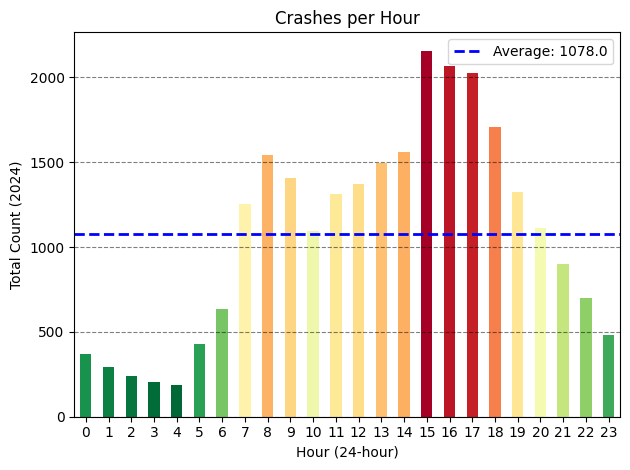

In [41]:
eda_2024['Hour'] = pd.to_datetime(eda_2024['Crash Date/Time']).dt.hour

# Crash counts per hour
crash_counts = eda_2024['Hour'].value_counts().sort_index()

# Normalize for color mapping
norm = (crash_counts - crash_counts.min()) / (crash_counts.max() - crash_counts.min())
colors = cm.RdYlGn_r(norm)

# Plot the bar chart without a legend from the bars
ax = crash_counts.plot(kind='bar', color=colors, legend=False)

# Calculate the average
avg = crash_counts.mean()

# Add a horizontal line for the average with a label for the legend
line = ax.axhline(avg, color='blue', linestyle='--', linewidth=2, label=f'Average: {avg:.1f}')

# Set legend to show only the horizontal line entry
plt.legend(handles=[line])

# add Y gride lines
plt.grid(axis='y', linestyle = '--', color= 'black', alpha= .5)
# Decorations
plt.title('Crashes per Hour')
plt.ylabel('Total Count (2024)')
plt.xlabel('Hour (24-hour)')

plt.xticks(rotation=0, ha='center')
plt.tight_layout()
plt.show()

DBSCAN

In [28]:
from sklearn.cluster import DBSCAN

dbdf_2024 = main_merge[main_merge['Year'] == 2024]

#Convert Lat/long ro radians
coordinates = dbdf_2024[['Latitude','Longitude']].to_numpy()
coordinates_rad = np.radians(coordinates)


#DBSCAN parameters
kms_per_radian = 6371.0088
epsilon_km = .05
epsilon = epsilon_km / kms_per_radian

dbs = DBSCAN(eps= epsilon, min_samples= 10, algorithm= 'ball_tree', metric= 'haversine')
dbdf_2024['cluster'] = dbs.fit_predict(coordinates_rad)

<ipython-input-28-c7419bbe467b>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  dbdf_2024['cluster'] = dbs.fit_predict(coordinates_rad)


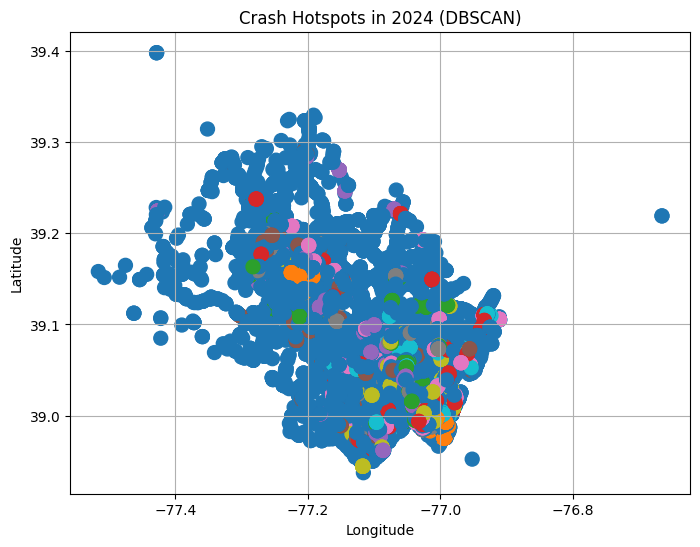

In [29]:
plt.figure(figsize=(8, 6))
plt.scatter(dbdf_2024['Longitude'], dbdf_2024['Latitude'], c=dbdf_2024['cluster'], cmap='tab10', s=100)


plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Crash Hotspots in 2024 (DBSCAN)')
plt.grid(True)

plt.show()


K-Means CLuster

In [30]:
from sklearn.cluster import KMeans

In [32]:
df_2024_kmeans = eda_2024.copy()

In [33]:
#main_merge_kmeans.info()
df_2024_kmeans = df_2024_kmeans.dropna(subset = ['Latitude', 'Longitude'])
xll = df_2024_kmeans[['Latitude', 'Longitude']]

xll.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25872 entries, 682 to 221594
Data columns (total 2 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Latitude   25872 non-null  float64
 1   Longitude  25872 non-null  float64
dtypes: float64(2)
memory usage: 606.4 KB


In [34]:
kmeans = KMeans(n_clusters=4, random_state=0)  # pick 4 groups
df_2024_kmeans['Cluster'] = kmeans.fit_predict(xll)  # add new column to show which cluster each accident belongs to
print(df_2024_kmeans[['Latitude', 'Longitude', 'Cluster']].head())



      Latitude  Longitude  Cluster
682  39.080570 -77.141298        0
683  39.080570 -77.141298        0
684  39.080570 -77.141298        0
685  39.080570 -77.141298        0
686  39.068174 -77.120345        0


In [35]:
center_lat = df_2024_kmeans['Latitude'].mean()
center_lon = df_2024_kmeans['Longitude'].mean()

map_clusters = folium.Map(location=[center_lat, center_lon], zoom_start=11)

In [36]:
# Pick some colors for the clusters
colors = ['red', 'blue', 'green', 'purple', 'orange', 'yellow', 'pink', 'gray']

# Loop through each accident and dot
for _, row in df_2024_kmeans.iterrows():
    folium.CircleMarker(
        location=[row['Latitude'], row['Longitude']],
        radius=.15,
        color=colors[row['Cluster'] % len(colors)],  # pick color based on cluster number
        fill=True,
        fill_opacity=0.2
    ).add_to(map_clusters)


In [37]:
map_clusters